# **PhysioNet 2022: The CirCor DigiScope Dataset**

The CirCor DigiScope dataset is a valuable collection of Phonocardiogram (PCG) recordings, designed to advance research in the field of cardiac auscultation. The dataset features comprehensive auscultation data from four primary locations: the pulmonary valve (PV), aortic valve (AV), mitral valve (MV), tricuspid valve (TV), and other miscellaneous locations denoted as Phc. These locations cover a diverse range of cardiac auscultation points, allowing for a thorough examination of cardiac sounds.

## **Data Formats:**

**Wave Recording Files (.wav Format)**:
The wave recording files in binary .wav format contain the heart sound data collected during auscultation at various locations. Each subject has a separate .wav file for each auscultation location, providing a detailed record of cardiac sounds. The .wav format is a standard audio file format widely used for storing waveforms, making it compatible with numerous audio processing tools.

**Segmentation Annotation Files (.tsv Format):**
The segmentation data files, stored in text .tsv format, contain crucial information about the temporal segmentation of heart sounds. Specifically, these files detail the start and end points of fundamental heart sounds S1 and S2. Each auscultation location for all subjects has a corresponding .tsv file, enabling the precise identification of cardiac events during signal processing.
Each row in the annotation file corresponds to a distinct wave segment and includes the start and end times (in seconds) of the detected wave. The third column employs a numerical identifier to distinguish different wave types, including S1 (1), systolic period (2), S2 (3), diastolic period (4), and unannotated segments i.e,noise (0). This standardized convention enhances the interpretability and utility of the segmentation annotations.

In [1]:
# Mount Google Drive in Google Colab
from google.colab import drive
drive.mount('/content/drive')

Mounted at /content/drive


In [2]:
# Import necessary libraries
import numpy as np
import soundfile as sf
from scipy.io import wavfile
from scipy.signal import hilbert
from scipy.signal import welch
from scipy.signal import butter, filtfilt
from scipy.spatial.distance import pdist
from scipy.signal import spectrogram
import matplotlib.pyplot as plt
import plotly.graph_objects as go

In [3]:
# Function to remove spikes from a signal
def remove_spike(input_signal):
    """
    Removes spikes from the input signal.

    Parameters:
    - input_signal: 1D numpy array, the input signal containing spikes.

    Returns:
    - dspike_signal: 1D numpy array, the signal with spikes removed.
    """
    R = 3
    dspike_signal = np.copy(input_signal)
    abs_signal = np.abs(input_signal)

    # Sort the absolute values of the signal in descending order
    sort_abs = np.sort(abs_signal)[::-1]

    # Calculate the threshold as the average of the first 10% amplitude
    TH = np.mean(sort_abs[:int(len(input_signal) * 0.1)])

    # Find the time position of samples which are greater than three times the threshold
    ind_spike = np.where(abs_signal > R * TH)[0]

    if len(ind_spike) > 0:
        L_one_percent = int(len(input_signal) * 0.01)  # not more than 1% samples will be replaced
        if len(ind_spike) > L_one_percent:
            ampi = np.argsort(abs_signal[ind_spike])[::-1]
            dspike_signal[ind_spike[ampi[:L_one_percent]]] = np.sign(input_signal[ind_spike[ampi[:L_one_percent]]]) * R * TH
        else:
            dspike_signal[ind_spike] = np.sign(input_signal[ind_spike]) * R * TH
    return dspike_signal

In [4]:
# Function for signal pre-processing
def pre_processing(input_signal, fs):
    """
    Pre-processes the input signal by removing spikes and baseline wandering.

    Parameters:
    - input_signal: 1D numpy array, the input signal to be pre-processed.
    - fs: float, the sampling frequency of the signal.

    Returns:
    - output_signal: 1D numpy array, the pre-processed signal.
    """
    # Normalize the input signal by dividing it by its standard deviation
    input_signal = input_signal / np.std(input_signal)

    # Remove spikes from the normalized signal
    dspike_signal = remove_spike(input_signal)

    # Remove baseline wandering using a high-pass filter with a cut-off frequency of 2 Hz
    fc = 2
    b, a = butter(3, 2 * fc / fs, 'high')
    dwander = filtfilt(b, a, dspike_signal)

    # Normalize the signal to standard deviation
    output_signal = dwander / np.std(dwander)

    return output_signal

In [5]:
def getDegree_cycle(rx, Min_cf, Max_cf, fs):
    """
    Compute the degree of periodicity for a given signal in a specified cycle frequency range.

    Parameters:
    - rx: 1D numpy array, the input signal.
    - Min_cf: float, the minimum cycle frequency considered.
    - Max_cf: float, the maximum cycle frequency considered.
    - fs: float, the sampling frequency of the signal.

    Returns:
    - degree_peak: float, the degree of periodicity.
    - g: 2D numpy array, the cycle frequency spectrum.
    - cycle_freq: 1D numpy array, the cycle frequencies corresponding to each column in g.
    """

    sz = len(rx)
    f_start = Min_cf  # Minimum cycle frequency considered
    f_end = Max_cf    # Maximum cycle frequency considered (in Hertz)
    M = int(2e2)      # Number of bins in cycle frequency domain (converted to int)

    # Compute the cycle frequency spectrum directly
    g = np.zeros((sz, M), dtype=np.complex128)

    for m in range(M):
        if m == 0:
            continue  # Skip m = 0 to avoid division by zero

        kk = np.arange(-sz + 1, sz)
        ww = np.exp(-1j * 2 * np.pi * (f_end - f_start) * m / (M * fs)) ** (kk**2 / 2)

        # Square and take the square root of the Hilbert transform of the input signal
        x = np.abs(hilbert(rx)) ** 2
        x = np.sqrt(np.maximum(x - np.mean(x), 0))

        nn = np.arange(sz)
        aa = np.exp(1j * 2 * np.pi * f_start * m / fs) ** nn
        aa = aa * ww[:sz]

        y = x * aa

        # Direct convolution
        g[:, m] = np.convolve(y, 1 / ww[:sz], mode='valid') * ww[M-1:M+sz-1]

    # Sum up all rows for each column and convert the g to a 1D vector of size M
    g_vector = np.abs(g).sum(axis=0)[:M]

    # The second indicator for the degree of periodicity
    # The higher the peak, the more periodic the signal is.
    degree_peak = np.max(g_vector) / np.median(g_vector)

    # Generate the cycle frequencies corresponding to each column in g
    cycle_freq = np.linspace(f_start, f_end, len(g))

    return degree_peak, g, cycle_freq

In [6]:
def getDegree_cycle_sliding_window(rx, Min_cf, Max_cf, fs, window_size, overlap):
    """
    Compute the degree of periodicity for a signal using a sliding window approach.

    Parameters:
    - rx: 1D numpy array, the input signal.
    - Min_cf: float, the minimum cycle frequency considered.
    - Max_cf: float, the maximum cycle frequency considered.
    - fs: float, the sampling frequency of the signal.
    - window_size: float, the size of the sliding window in seconds.
    - overlap: float, the overlap between consecutive windows (as a fraction).

    Returns:
    - degree_peak_values: 1D numpy array, degree of periodicity for each window.
    - time_values: 1D numpy array, time values corresponding to the center of each window.
    """

    sz = len(rx)
    window_size = int(window_size * fs)  # Convert window size to an integer
    step_size = int(window_size * (1 - overlap))

    # Initialize arrays to store results
    degree_peak_values = []
    time_values = []

    for start in range(0, sz - window_size + 1, step_size):
        end = start + window_size

        # Extract the current window of the signal
        windowed_signal = rx[start:end]

        # Calculate the degree of periodicity for the current window
        degree_peak, _, _ = getDegree_cycle(windowed_signal, Min_cf, Max_cf, fs)

        # Calculate the time corresponding to the center of the window
        center_time = (start + end) / (2.0 * fs)

        # Append results to arrays
        degree_peak_values.append(degree_peak)
        time_values.append(center_time)

    return degree_peak_values, time_values

In [7]:
Min_cf = 0.0  # Minimum cycle frequency considered
Max_cf = 2.0  # Maximum cycle frequency considered
window_size = 8.0  # Window size in seconds
overlap = 0.98 # Overlap ratio

In [ ]:
# Load the audio file
file_path = '/content/drive/MyDrive/Noisy Recordings/13918_MV.wav'
fs, signal = wavfile.read(file_path)

# Apply pre-processing to the signal
phs = pre_processing(signal, fs)

# Apply the sliding window analysis to the signal
degree_peak_values, time_values = getDegree_cycle_sliding_window(phs, Min_cf, Max_cf, fs, window_size, overlap)

# Plot the degree of periodicity vs time using Plotly
fig_degree = go.Figure()

fig_degree.add_trace(go.Scatter(
    x=time_values,
    y=degree_peak_values,
    mode='lines',
    name='Degree of Periodicity'
))

fig_degree.update_layout(
    title='Degree of Periodicity vs Time',
    xaxis_title='Time (s)',
    yaxis_title='Degree of Periodicity',
    legend=dict(x=0, y=1, traceorder='normal')
)

# Show the interactive plot for degree of periodicity vs time
fig_degree.show()

# Plot amplitude vs time using Plotly
fig_amplitude = go.Figure()

time_values_amplitude = np.arange(len(phs)) / fs

fig_amplitude.add_trace(go.Scatter(
    x=time_values_amplitude,
    y=phs,
    mode='lines',
    name='Amplitude'
))

fig_amplitude.update_layout(
    title='Amplitude vs Time for Input Signal',
    xaxis_title='Time (s)',
    yaxis_title='Amplitude',
    legend=dict(x=0, y=1, traceorder='normal')
)

# Show the interactive plot for amplitude vs time
fig_amplitude.show()

The provided Python script aims to analyze and visualize periodicity in time-series data, particularly focusing on identifying time intervals with significant peaks in a given degree of periodicity. It first calculates a threshold value based on the 30th percentile of a variable called `degree_peak_values`. Subsequently, a binary mask is created by comparing each element in `degree_peak_values` to this threshold, resulting in a binary classification where values above or equal to the threshold are set to 1, and the rest to 0.

The script then reads time-series data from a TSV file, specifically extracting columns related to start times, end times, and a noise signal. A binary mask is generated from the noise signal, designating time points where the noise is non-zero with a value of 1, and zero otherwise.

In [ ]:
import numpy as np
import matplotlib.pyplot as plt
import plotly.graph_objects as go

# Calculate the 30th percentile of degree_peak_values
threshold = np.percentile(degree_peak_values, 30)

# Create binary mask based on the threshold
binary_mask = (degree_peak_values >= threshold).astype(int)

# Read the TSV file
data = np.genfromtxt('/content/drive/MyDrive/Noisy Recordings/13918_MV.tsv', delimiter='\t')

# Extract columns
start_time = data[:, 0]
end_time = data[:, 1]
noise_column = data[:, 2]

# Create a binary mask
mask = (noise_column != 0).astype(int)

# Combine start_time and end_time into a single array
time_points = np.sort(np.concatenate([start_time, end_time]))

# Create a corresponding mask for each time point
mask_values = np.repeat(mask, 2)

To visually represent these binary masks, the script uses the Plotly library to create an interactive graph. Two line plots are generated on the same graph: one representing the binary mask derived from the degree of periodicity and the other from the annotations in the noise signal. The resulting visualization provides a comparison between the identified noisy part of the signal and the annotated noisy intervals, aiding in the understanding of how well the algorithm captures significant noise in the data.

In [ ]:
fig_binary_mask = go.Figure()

fig_binary_mask.add_trace(go.Scatter(
    x=time_values,
    y=binary_mask,
    mode='lines',
    name='Binary Mask (from degree of periodicity)'
))

fig_binary_mask.update_layout(
    title='Binary Mask vs Time',
    xaxis_title='Time (s)',
    yaxis_title='Binary Mask',
    legend=dict(x=0, y=1, traceorder='normal')
)

fig_binary_mask.add_trace(go.Scatter(
    x=time_points,
    y=mask_values,
    mode='lines',
    name='Binary Mask (from annotations)'
))

# Show the combined plot
fig_binary_mask.show()

The subsequent code snippets exclusively operate on a signal containing noise, intentionally omitting the use of a completely clean signal. This deliberate choice aligns with the objective of identifying and isolating corrupted segments within the data. The focus is on discerning patterns and significant peaks in a signal that incorporates noise, reflecting real-world scenarios where noise can obscure meaningful information. The code employs a trial-and-error method to determine the threshold value crucial for distinguishing between noise and signal. The range of threshold values explored spans from 30 to 40, as values exceeding 40 may lead to an excessively high threshold, potentially misclassifying clean segments as noise. Conversely, values below 30 are found to be inadequate in effectively identifying noisy segments. This iterative approach to threshold selection underscores the careful consideration given to balance between sensitivity to noise and the risk of overlooking genuine periodic patterns in the signal.

In [ ]:
# Load the audio file
file_path = '/content/drive/MyDrive/Noisy Recordings/14241_MV.wav'
fs, signal = wavfile.read(file_path)

# Apply pre-processing to the signal
phs = pre_processing(signal, fs)

# Apply the sliding window analysis to the signal
degree_peak_values, time_values = getDegree_cycle_sliding_window(phs, Min_cf, Max_cf, fs, window_size, overlap)

# Plot the degree of periodicity vs time using Plotly
fig_degree = go.Figure()

fig_degree.add_trace(go.Scatter(
    x=time_values,
    y=degree_peak_values,
    mode='lines',
    name='Degree of Periodicity'
))

fig_degree.update_layout(
    title='Degree of Periodicity vs Time',
    xaxis_title='Time (s)',
    yaxis_title='Degree of Periodicity',
    legend=dict(x=0, y=1, traceorder='normal')
)

# Show the interactive plot for degree of periodicity vs time
fig_degree.show()

# Plot amplitude vs time using Plotly
fig_amplitude = go.Figure()

time_values_amplitude = np.arange(len(phs)) / fs

fig_amplitude.add_trace(go.Scatter(
    x=time_values_amplitude,
    y=phs,
    mode='lines',
    name='Amplitude'
))

fig_amplitude.update_layout(
    title='Amplitude vs Time for Input Signal',
    xaxis_title='Time (s)',
    yaxis_title='Amplitude',
    legend=dict(x=0, y=1, traceorder='normal')
)

# Show the interactive plot for amplitude vs time
fig_amplitude.show()

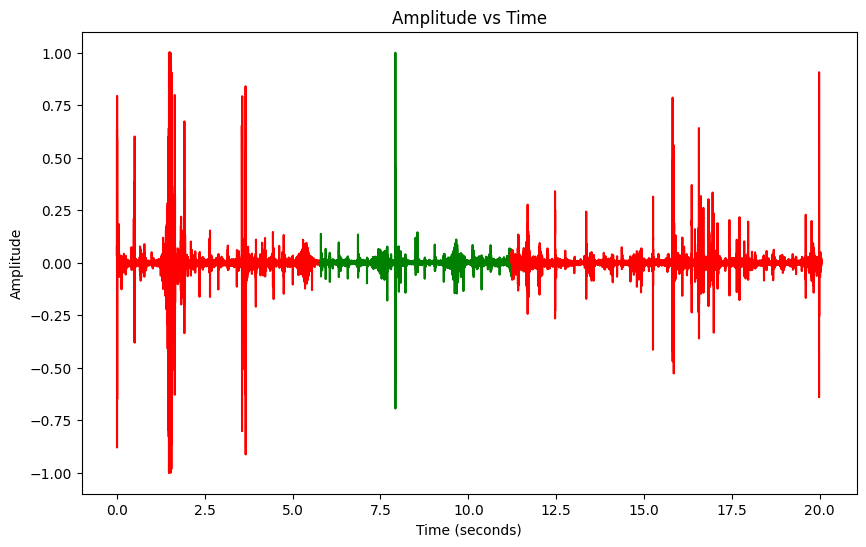

In [ ]:
# Load the WAV file
wav_file = '/content/drive/MyDrive/Noisy Recordings/14241_MV.wav'
signal, sample_rate = sf.read(wav_file)

# Read the TSV file
data = np.genfromtxt('/content/drive/MyDrive/Noisy Recordings/14241_MV.tsv', delimiter='\t')

# Extract columns
start_time = data[:, 0]
end_time = data[:, 1]
noise_column = data[:, 2]

# Plot the signal with color-coded noise sections (Red- Noise, Green- Clean Signal)
plt.figure(figsize=(10, 6))

for i in range(len(start_time)):
    start_index = int(start_time[i] * sample_rate)
    end_index = int(end_time[i] * sample_rate)
    if noise_column[i] == 0:
        plt.plot(np.arange(start_index, end_index) / sample_rate, signal[start_index:end_index], color='red')
    else:
        plt.plot(np.arange(start_index, end_index) / sample_rate, signal[start_index:end_index], color='green')

plt.title('Amplitude vs Time')
plt.xlabel('Time (seconds)')
plt.ylabel('Amplitude')
plt.show()

In [ ]:
# Calculate the 37th percentile of degree_peak_values
threshold = np.percentile(degree_peak_values, 37)

# Create binary mask based on the threshold
binary_mask = (degree_peak_values >= threshold).astype(int)

# Read the TSV file
data = np.genfromtxt('/content/drive/MyDrive/Noisy Recordings/14241_MV.tsv', delimiter='\t')

# Extract columns
start_time = data[:, 0]
end_time = data[:, 1]
noise_column = data[:, 2]

# Create a binary mask
mask = (noise_column != 0).astype(int)

# Combine start_time and end_time into a single array
time_points = np.sort(np.concatenate([start_time, end_time]))

# Create a corresponding mask for each time point
mask_values = np.repeat(mask, 2)

In [ ]:
fig_binary_mask = go.Figure()

fig_binary_mask.add_trace(go.Scatter(
    x=time_values,
    y=binary_mask,
    mode='lines',
    name='Binary Mask (from degree of periodicity)'
))

fig_binary_mask.update_layout(
    title='Binary Mask vs Time',
    xaxis_title='Time (s)',
    yaxis_title='Binary Mask',
    legend=dict(x=0, y=1, traceorder='normal')
)

fig_binary_mask.add_trace(go.Scatter(
    x=time_points,
    y=mask_values,
    mode='lines',
    name='Binary Mask (from annotations)'
))

# Show the combined plot
fig_binary_mask.show()

In [ ]:
file_path = '/content/drive/MyDrive/Noisy Recordings/14998_MV.wav'
fs, signal = wavfile.read(file_path)

# Apply pre-processing to the signal
phs = pre_processing(signal, fs)

# Apply the sliding window analysis to the signal
degree_peak_values, time_values = getDegree_cycle_sliding_window(phs, Min_cf, Max_cf, fs, window_size, overlap)

# Plot the degree of periodicity vs time using Plotly
fig_degree = go.Figure()

fig_degree.add_trace(go.Scatter(
    x=time_values,
    y=degree_peak_values,
    mode='lines',
    name='Degree of Periodicity'
))

fig_degree.update_layout(
    title='Degree of Periodicity vs Time',
    xaxis_title='Time (s)',
    yaxis_title='Degree of Periodicity',
    legend=dict(x=0, y=1, traceorder='normal')
)

# Show the interactive plot for degree of periodicity vs time
fig_degree.show()

# Plot amplitude vs time using Plotly
fig_amplitude = go.Figure()

time_values_amplitude = np.arange(len(phs)) / fs

fig_amplitude.add_trace(go.Scatter(
    x=time_values_amplitude,
    y=phs,
    mode='lines',
    name='Amplitude'
))

fig_amplitude.update_layout(
    title='Amplitude vs Time for Input Signal',
    xaxis_title='Time (s)',
    yaxis_title='Amplitude',
    legend=dict(x=0, y=1, traceorder='normal')
)

# Show the interactive plot for amplitude vs time
fig_amplitude.show()

In [ ]:
# Calculate the 41th percentile of degree_peak_values
threshold = np.percentile(degree_peak_values, 41)

# Create binary mask based on the threshold
binary_mask = (degree_peak_values >= threshold).astype(int)

# Read the TSV file
data = np.genfromtxt('/content/drive/MyDrive/Noisy Recordings/14998_MV.tsv', delimiter='\t')

# Extract columns
start_time = data[:, 0]
end_time = data[:, 1]
noise_column = data[:, 2]

# Create a binary mask
mask = (noise_column != 0).astype(int)

# Combine start_time and end_time into a single array
time_points = np.sort(np.concatenate([start_time, end_time]))

# Create a corresponding mask for each time point
mask_values = np.repeat(mask, 2)

In [ ]:
fig_binary_mask = go.Figure()

fig_binary_mask.add_trace(go.Scatter(
    x=time_values,
    y=binary_mask,
    mode='lines',
    name='Binary Mask (from degree of periodicity)'
))

fig_binary_mask.update_layout(
    title='Binary Mask vs Time',
    xaxis_title='Time (s)',
    yaxis_title='Binary Mask',
    legend=dict(x=0, y=1, traceorder='normal')
)

fig_binary_mask.add_trace(go.Scatter(
    x=time_points,
    y=mask_values,
    mode='lines',
    name='Binary Mask (from annotations)'
))

# Show the combined plot
fig_binary_mask.show()

In [ ]:
file_path = '/content/drive/MyDrive/Noisy Recordings/23625_MV.wav'
fs, signal = wavfile.read(file_path)

# Apply pre-processing to the signal
phs = pre_processing(signal, fs)

# Apply the sliding window analysis to the signal
degree_peak_values, time_values = getDegree_cycle_sliding_window(phs, Min_cf, Max_cf, fs, window_size, overlap)

# Plot the degree of periodicity vs time using Plotly
fig_degree = go.Figure()

fig_degree.add_trace(go.Scatter(
    x=time_values,
    y=degree_peak_values,
    mode='lines',
    name='Degree of Periodicity'
))

fig_degree.update_layout(
    title='Degree of Periodicity vs Time',
    xaxis_title='Time (s)',
    yaxis_title='Degree of Periodicity',
    legend=dict(x=0, y=1, traceorder='normal')
)

# Show the interactive plot for degree of periodicity vs time
fig_degree.show()

# Plot amplitude vs time using Plotly
fig_amplitude = go.Figure()

time_values_amplitude = np.arange(len(phs)) / fs

fig_amplitude.add_trace(go.Scatter(
    x=time_values_amplitude,
    y=phs,
    mode='lines',
    name='Amplitude'
))

fig_amplitude.update_layout(
    title='Amplitude vs Time for Input Signal',
    xaxis_title='Time (s)',
    yaxis_title='Amplitude',
    legend=dict(x=0, y=1, traceorder='normal')
)

# Show the interactive plot for amplitude vs time
fig_amplitude.show()

In [ ]:
# Calculate the 35th percentile of degree_peak_values
threshold = np.percentile(degree_peak_values, 35)

# Create binary mask based on the threshold
binary_mask = (degree_peak_values >= threshold).astype(int)

# Read the TSV file
data = np.genfromtxt('/content/drive/MyDrive/Noisy Recordings/23625_MV.tsv', delimiter='\t')

# Extract columns
start_time = data[:, 0]
end_time = data[:, 1]
noise_column = data[:, 2]

# Create a binary mask
mask = (noise_column != 0).astype(int)

# Combine start_time and end_time into a single array
time_points = np.sort(np.concatenate([start_time, end_time]))

# Create a corresponding mask for each time point
mask_values = np.repeat(mask, 2)

In [ ]:
fig_binary_mask = go.Figure()

fig_binary_mask.add_trace(go.Scatter(
    x=time_values,
    y=binary_mask,
    mode='lines',
    name='Binary Mask (from degree of periodicity)'
))

fig_binary_mask.update_layout(
    title='Binary Mask vs Time',
    xaxis_title='Time (s)',
    yaxis_title='Binary Mask',
    legend=dict(x=0, y=1, traceorder='normal')
)

fig_binary_mask.add_trace(go.Scatter(
    x=time_points,
    y=mask_values,
    mode='lines',
    name='Binary Mask (from annotations)'
))

# Show the combined plot
fig_binary_mask.show()

In [ ]:
file_path = '/content/drive/MyDrive/Noisy Recordings/24160_MV.wav'
fs, signal = wavfile.read(file_path)

# Apply pre-processing to the signal
phs = pre_processing(signal, fs)

# Apply the sliding window analysis to the signal
degree_peak_values, time_values = getDegree_cycle_sliding_window(phs, Min_cf, Max_cf, fs, window_size, overlap)

# Plot the degree of periodicity vs time using Plotly
fig_degree = go.Figure()

fig_degree.add_trace(go.Scatter(
    x=time_values,
    y=degree_peak_values,
    mode='lines',
    name='Degree of Periodicity'
))

fig_degree.update_layout(
    title='Degree of Periodicity vs Time',
    xaxis_title='Time (s)',
    yaxis_title='Degree of Periodicity',
    legend=dict(x=0, y=1, traceorder='normal')
)

# Show the interactive plot for degree of periodicity vs time
fig_degree.show()

# Plot amplitude vs time using Plotly
fig_amplitude = go.Figure()

time_values_amplitude = np.arange(len(phs)) / fs

fig_amplitude.add_trace(go.Scatter(
    x=time_values_amplitude,
    y=phs,
    mode='lines',
    name='Amplitude'
))

fig_amplitude.update_layout(
    title='Amplitude vs Time for Input Signal',
    xaxis_title='Time (s)',
    yaxis_title='Amplitude',
    legend=dict(x=0, y=1, traceorder='normal')
)

# Show the interactive plot for amplitude vs time
fig_amplitude.show()

In [ ]:
# Calculate the 35th percentile of degree_peak_values
threshold = np.percentile(degree_peak_values, 35)

# Create binary mask based on the threshold
binary_mask = (degree_peak_values >= threshold).astype(int)

# Read the TSV file
data = np.genfromtxt('/content/drive/MyDrive/Noisy Recordings/24160_MV.tsv', delimiter='\t')

# Extract columns
start_time = data[:, 0]
end_time = data[:, 1]
noise_column = data[:, 2]

# Create a binary mask
mask = (noise_column != 0).astype(int)

# Combine start_time and end_time into a single array
time_points = np.sort(np.concatenate([start_time, end_time]))

# Create a corresponding mask for each time point
mask_values = np.repeat(mask, 2)

In [ ]:
fig_binary_mask = go.Figure()

fig_binary_mask.add_trace(go.Scatter(
    x=time_values,
    y=binary_mask,
    mode='lines',
    name='Binary Mask (from degree of periodicity)'
))

fig_binary_mask.update_layout(
    title='Binary Mask vs Time',
    xaxis_title='Time (s)',
    yaxis_title='Binary Mask',
    legend=dict(x=0, y=1, traceorder='normal')
)

fig_binary_mask.add_trace(go.Scatter(
    x=time_points,
    y=mask_values,
    mode='lines',
    name='Binary Mask (from annotations)'
))

# Show the combined plot
fig_binary_mask.show()

In [ ]:
file_path = '/content/drive/MyDrive/Noisy Recordings/2530_MV.wav'
fs, signal = wavfile.read(file_path)

# Apply pre-processing to the signal
phs = pre_processing(signal, fs)

# Apply the sliding window analysis to the signal
degree_peak_values, time_values = getDegree_cycle_sliding_window(phs, Min_cf, Max_cf, fs, window_size, overlap)

# Plot the degree of periodicity vs time using Plotly
fig_degree = go.Figure()

fig_degree.add_trace(go.Scatter(
    x=time_values,
    y=degree_peak_values,
    mode='lines',
    name='Degree of Periodicity'
))

fig_degree.update_layout(
    title='Degree of Periodicity vs Time',
    xaxis_title='Time (s)',
    yaxis_title='Degree of Periodicity',
    legend=dict(x=0, y=1, traceorder='normal')
)

# Show the interactive plot for degree of periodicity vs time
fig_degree.show()

# Plot amplitude vs time using Plotly
fig_amplitude = go.Figure()

time_values_amplitude = np.arange(len(phs)) / fs

fig_amplitude.add_trace(go.Scatter(
    x=time_values_amplitude,
    y=phs,
    mode='lines',
    name='Amplitude'
))

fig_amplitude.update_layout(
    title='Amplitude vs Time for Input Signal',
    xaxis_title='Time (s)',
    yaxis_title='Amplitude',
    legend=dict(x=0, y=1, traceorder='normal')
)

# Show the interactive plot for amplitude vs time
fig_amplitude.show()

In [ ]:
# Calculate the 40th percentile of degree_peak_values
threshold = np.percentile(degree_peak_values, 40)

# Create binary mask based on the threshold
binary_mask = (degree_peak_values >= threshold).astype(int)

# Read the TSV file
data = np.genfromtxt('/content/drive/MyDrive/Noisy Recordings/2530_MV.tsv', delimiter='\t')

# Extract columns
start_time = data[:, 0]
end_time = data[:, 1]
noise_column = data[:, 2]

# Create a binary mask
mask = (noise_column != 0).astype(int)

# Combine start_time and end_time into a single array
time_points = np.sort(np.concatenate([start_time, end_time]))

# Create a corresponding mask for each time point
mask_values = np.repeat(mask, 2)

In [ ]:
fig_binary_mask = go.Figure()

fig_binary_mask.add_trace(go.Scatter(
    x=time_values,
    y=binary_mask,
    mode='lines',
    name='Binary Mask (from degree of periodicity)'
))

fig_binary_mask.update_layout(
    title='Binary Mask vs Time',
    xaxis_title='Time (s)',
    yaxis_title='Binary Mask',
    legend=dict(x=0, y=1, traceorder='normal')
)

fig_binary_mask.add_trace(go.Scatter(
    x=time_points,
    y=mask_values,
    mode='lines',
    name='Binary Mask (from annotations)'
))

# Show the combined plot
fig_binary_mask.show()

In [ ]:
file_path = '/content/drive/MyDrive/Noisy Recordings/29045_MV.wav'
fs, signal = wavfile.read(file_path)

# Apply pre-processing to the signal
phs = pre_processing(signal, fs)

# Apply the sliding window analysis to the signal
degree_peak_values, time_values = getDegree_cycle_sliding_window(phs, Min_cf, Max_cf, fs, window_size, overlap)

# Plot the degree of periodicity vs time using Plotly
fig_degree = go.Figure()

fig_degree.add_trace(go.Scatter(
    x=time_values,
    y=degree_peak_values,
    mode='lines',
    name='Degree of Periodicity'
))

fig_degree.update_layout(
    title='Degree of Periodicity vs Time',
    xaxis_title='Time (s)',
    yaxis_title='Degree of Periodicity',
    legend=dict(x=0, y=1, traceorder='normal')
)

# Show the interactive plot for degree of periodicity vs time
fig_degree.show()

# Plot amplitude vs time using Plotly
fig_amplitude = go.Figure()

time_values_amplitude = np.arange(len(phs)) / fs

fig_amplitude.add_trace(go.Scatter(
    x=time_values_amplitude,
    y=phs,
    mode='lines',
    name='Amplitude'
))

fig_amplitude.update_layout(
    title='Amplitude vs Time for Input Signal',
    xaxis_title='Time (s)',
    yaxis_title='Amplitude',
    legend=dict(x=0, y=1, traceorder='normal')
)

# Show the interactive plot for amplitude vs time
fig_amplitude.show()

In [ ]:
# Calculate the 30th percentile of degree_peak_values
threshold = np.percentile(degree_peak_values, 30)

# Create binary mask based on the threshold
binary_mask = (degree_peak_values >= threshold).astype(int)

# Read the TSV file
data = np.genfromtxt('/content/drive/MyDrive/Noisy Recordings/29045_MV.tsv', delimiter='\t')

# Extract columns
start_time = data[:, 0]
end_time = data[:, 1]
noise_column = data[:, 2]

# Create a binary mask
mask = (noise_column != 0).astype(int)

# Combine start_time and end_time into a single array
time_points = np.sort(np.concatenate([start_time, end_time]))

# Create a corresponding mask for each time point
mask_values = np.repeat(mask, 2)

In [ ]:
fig_binary_mask = go.Figure()

fig_binary_mask.add_trace(go.Scatter(
    x=time_values,
    y=binary_mask,
    mode='lines',
    name='Binary Mask (from degree of periodicity)'
))

fig_binary_mask.update_layout(
    title='Binary Mask vs Time',
    xaxis_title='Time (s)',
    yaxis_title='Binary Mask',
    legend=dict(x=0, y=1, traceorder='normal')
)

fig_binary_mask.add_trace(go.Scatter(
    x=time_points,
    y=mask_values,
    mode='lines',
    name='Binary Mask (from annotations)'
))

# Show the combined plot
fig_binary_mask.show()

In [ ]:
file_path = '/content/drive/MyDrive/Noisy Recordings/29378_MV.wav'
fs, signal = wavfile.read(file_path)

# Apply pre-processing to the signal
phs = pre_processing(signal, fs)

# Apply the sliding window analysis to the signal
degree_peak_values, time_values = getDegree_cycle_sliding_window(phs, Min_cf, Max_cf, fs, window_size, overlap)

# Plot the degree of periodicity vs time using Plotly
fig_degree = go.Figure()

fig_degree.add_trace(go.Scatter(
    x=time_values,
    y=degree_peak_values,
    mode='lines',
    name='Degree of Periodicity'
))

fig_degree.update_layout(
    title='Degree of Periodicity vs Time',
    xaxis_title='Time (s)',
    yaxis_title='Degree of Periodicity',
    legend=dict(x=0, y=1, traceorder='normal')
)

# Show the interactive plot for degree of periodicity vs time
fig_degree.show()

# Plot amplitude vs time using Plotly
fig_amplitude = go.Figure()

time_values_amplitude = np.arange(len(phs)) / fs

fig_amplitude.add_trace(go.Scatter(
    x=time_values_amplitude,
    y=phs,
    mode='lines',
    name='Amplitude'
))

fig_amplitude.update_layout(
    title='Amplitude vs Time for Input Signal',
    xaxis_title='Time (s)',
    yaxis_title='Amplitude',
    legend=dict(x=0, y=1, traceorder='normal')
)

# Show the interactive plot for amplitude vs time
fig_amplitude.show()

In [ ]:
# Calculate the 30th percentile of degree_peak_values
threshold = np.percentile(degree_peak_values, 30)

# Create binary mask based on the threshold
binary_mask = (degree_peak_values >= threshold).astype(int)

# Read the TSV file
data = np.genfromtxt('/content/drive/MyDrive/Noisy Recordings/29378_MV.tsv', delimiter='\t')

# Extract columns
start_time = data[:, 0]
end_time = data[:, 1]
noise_column = data[:, 2]

# Create a binary mask
mask = (noise_column != 0).astype(int)

# Combine start_time and end_time into a single array
time_points = np.sort(np.concatenate([start_time, end_time]))

# Create a corresponding mask for each time point
mask_values = np.repeat(mask, 2)

In [ ]:
fig_binary_mask = go.Figure()

fig_binary_mask.add_trace(go.Scatter(
    x=time_values,
    y=binary_mask,
    mode='lines',
    name='Binary Mask (from degree of periodicity)'
))

fig_binary_mask.update_layout(
    title='Binary Mask vs Time',
    xaxis_title='Time (s)',
    yaxis_title='Binary Mask',
    legend=dict(x=0, y=1, traceorder='normal')
)

fig_binary_mask.add_trace(go.Scatter(
    x=time_points,
    y=mask_values,
    mode='lines',
    name='Binary Mask (from annotations)'
))

# Show the combined plot
fig_binary_mask.show()

In [ ]:
file_path = '/content/drive/MyDrive/Noisy Recordings/33151_MV.wav'
fs, signal = wavfile.read(file_path)

# Apply pre-processing to the signal
phs = pre_processing(signal, fs)

# Apply the sliding window analysis to the signal
degree_peak_values, time_values = getDegree_cycle_sliding_window(phs, Min_cf, Max_cf, fs, window_size, overlap)

# Plot the degree of periodicity vs time using Plotly
fig_degree = go.Figure()

fig_degree.add_trace(go.Scatter(
    x=time_values,
    y=degree_peak_values,
    mode='lines',
    name='Degree of Periodicity'
))

fig_degree.update_layout(
    title='Degree of Periodicity vs Time',
    xaxis_title='Time (s)',
    yaxis_title='Degree of Periodicity',
    legend=dict(x=0, y=1, traceorder='normal')
)

# Show the interactive plot for degree of periodicity vs time
fig_degree.show()

# Plot amplitude vs time using Plotly
fig_amplitude = go.Figure()

time_values_amplitude = np.arange(len(phs)) / fs

fig_amplitude.add_trace(go.Scatter(
    x=time_values_amplitude,
    y=phs,
    mode='lines',
    name='Amplitude'
))

fig_amplitude.update_layout(
    title='Amplitude vs Time for Input Signal',
    xaxis_title='Time (s)',
    yaxis_title='Amplitude',
    legend=dict(x=0, y=1, traceorder='normal')
)

# Show the interactive plot for amplitude vs time
fig_amplitude.show()

In [ ]:
# Calculate the 35th percentile of degree_peak_values
threshold = np.percentile(degree_peak_values, 35)

# Create binary mask based on the threshold
binary_mask = (degree_peak_values >= threshold).astype(int)

# Read the TSV file
data = np.genfromtxt('/content/drive/MyDrive/Noisy Recordings/33151_MV.tsv', delimiter='\t')

# Extract columns
start_time = data[:, 0]
end_time = data[:, 1]
noise_column = data[:, 2]

# Create a binary mask
mask = (noise_column != 0).astype(int)

# Combine start_time and end_time into a single array
time_points = np.sort(np.concatenate([start_time, end_time]))

# Create a corresponding mask for each time point
mask_values = np.repeat(mask, 2)

In [ ]:
fig_binary_mask = go.Figure()

fig_binary_mask.add_trace(go.Scatter(
    x=time_values,
    y=binary_mask,
    mode='lines',
    name='Binary Mask (from degree of periodicity)'
))

fig_binary_mask.update_layout(
    title='Binary Mask vs Time',
    xaxis_title='Time (s)',
    yaxis_title='Binary Mask',
    legend=dict(x=0, y=1, traceorder='normal')
)

fig_binary_mask.add_trace(go.Scatter(
    x=time_points,
    y=mask_values,
    mode='lines',
    name='Binary Mask (from annotations)'
))

# Show the combined plot
fig_binary_mask.show()

In [ ]:
file_path = '/content/drive/MyDrive/Noisy Recordings/36327_MV.wav'
fs, signal = wavfile.read(file_path)

# Apply pre-processing to the signal
phs = pre_processing(signal, fs)

# Apply the sliding window analysis to the signal
degree_peak_values, time_values = getDegree_cycle_sliding_window(phs, Min_cf, Max_cf, fs, window_size, overlap)

# Plot the degree of periodicity vs time using Plotly
fig_degree = go.Figure()

fig_degree.add_trace(go.Scatter(
    x=time_values,
    y=degree_peak_values,
    mode='lines',
    name='Degree of Periodicity'
))

fig_degree.update_layout(
    title='Degree of Periodicity vs Time',
    xaxis_title='Time (s)',
    yaxis_title='Degree of Periodicity',
    legend=dict(x=0, y=1, traceorder='normal')
)

# Show the interactive plot for degree of periodicity vs time
fig_degree.show()

# Plot amplitude vs time using Plotly
fig_amplitude = go.Figure()

time_values_amplitude = np.arange(len(phs)) / fs

fig_amplitude.add_trace(go.Scatter(
    x=time_values_amplitude,
    y=phs,
    mode='lines',
    name='Amplitude'
))

fig_amplitude.update_layout(
    title='Amplitude vs Time for Input Signal',
    xaxis_title='Time (s)',
    yaxis_title='Amplitude',
    legend=dict(x=0, y=1, traceorder='normal')
)

# Show the interactive plot for amplitude vs time
fig_amplitude.show()

In [ ]:
# Calculate the 30th percentile of degree_peak_values
threshold = np.percentile(degree_peak_values, 30)

# Create binary mask based on the threshold
binary_mask = (degree_peak_values >= threshold).astype(int)

# Read the TSV file
data = np.genfromtxt('/content/drive/MyDrive/Noisy Recordings/36327_MV.tsv', delimiter='\t')

# Extract columns
start_time = data[:, 0]
end_time = data[:, 1]
noise_column = data[:, 2]

# Create a binary mask
mask = (noise_column != 0).astype(int)

# Combine start_time and end_time into a single array
time_points = np.sort(np.concatenate([start_time, end_time]))

# Create a corresponding mask for each time point
mask_values = np.repeat(mask, 2)

In [ ]:
fig_binary_mask = go.Figure()

fig_binary_mask.add_trace(go.Scatter(
    x=time_values,
    y=binary_mask,
    mode='lines',
    name='Binary Mask (from degree of periodicity)'
))

fig_binary_mask.update_layout(
    title='Binary Mask vs Time',
    xaxis_title='Time (s)',
    yaxis_title='Binary Mask',
    legend=dict(x=0, y=1, traceorder='normal')
)

fig_binary_mask.add_trace(go.Scatter(
    x=time_points,
    y=mask_values,
    mode='lines',
    name='Binary Mask (from annotations)'
))

# Show the combined plot
fig_binary_mask.show()

In [ ]:
file_path = '/content/drive/MyDrive/Noisy Recordings/38337_MV.wav'
fs, signal = wavfile.read(file_path)

# Apply pre-processing to the signal
phs = pre_processing(signal, fs)

# Apply the sliding window analysis to the signal
degree_peak_values, time_values = getDegree_cycle_sliding_window(phs, Min_cf, Max_cf, fs, window_size, overlap)

# Plot the degree of periodicity vs time using Plotly
fig_degree = go.Figure()

fig_degree.add_trace(go.Scatter(
    x=time_values,
    y=degree_peak_values,
    mode='lines',
    name='Degree of Periodicity'
))

fig_degree.update_layout(
    title='Degree of Periodicity vs Time',
    xaxis_title='Time (s)',
    yaxis_title='Degree of Periodicity',
    legend=dict(x=0, y=1, traceorder='normal')
)

# Show the interactive plot for degree of periodicity vs time
fig_degree.show()

# Plot amplitude vs time using Plotly
fig_amplitude = go.Figure()

time_values_amplitude = np.arange(len(phs)) / fs

fig_amplitude.add_trace(go.Scatter(
    x=time_values_amplitude,
    y=phs,
    mode='lines',
    name='Amplitude'
))

fig_amplitude.update_layout(
    title='Amplitude vs Time for Input Signal',
    xaxis_title='Time (s)',
    yaxis_title='Amplitude',
    legend=dict(x=0, y=1, traceorder='normal')
)

# Show the interactive plot for amplitude vs time
fig_amplitude.show()

In [ ]:
# Calculate the 30th percentile of degree_peak_values
threshold = np.percentile(degree_peak_values, 30)

# Create binary mask based on the threshold
binary_mask = (degree_peak_values >= threshold).astype(int)

# Read the TSV file
data = np.genfromtxt('/content/drive/MyDrive/Noisy Recordings/38337_MV.tsv', delimiter='\t')

# Extract columns
start_time = data[:, 0]
end_time = data[:, 1]
noise_column = data[:, 2]

# Create a binary mask
mask = (noise_column != 0).astype(int)

# Combine start_time and end_time into a single array
time_points = np.sort(np.concatenate([start_time, end_time]))

# Create a corresponding mask for each time point
mask_values = np.repeat(mask, 2)

In [ ]:
fig_binary_mask = go.Figure()

fig_binary_mask.add_trace(go.Scatter(
    x=time_values,
    y=binary_mask,
    mode='lines',
    name='Binary Mask (from degree of periodicity)'
))

fig_binary_mask.update_layout(
    title='Binary Mask vs Time',
    xaxis_title='Time (s)',
    yaxis_title='Binary Mask',
    legend=dict(x=0, y=1, traceorder='normal')
)

fig_binary_mask.add_trace(go.Scatter(
    x=time_points,
    y=mask_values,
    mode='lines',
    name='Binary Mask (from annotations)'
))

# Show the combined plot
fig_binary_mask.show()

In [8]:
file_path = '/content/drive/MyDrive/Noisy Recordings/39456_MV.wav'
fs, signal = wavfile.read(file_path)

# Apply pre-processing to the signal
phs = pre_processing(signal, fs)

# Apply the sliding window analysis to the signal
degree_peak_values, time_values = getDegree_cycle_sliding_window(phs, Min_cf, Max_cf, fs, window_size, overlap)

# Plot the degree of periodicity vs time using Plotly
fig_degree = go.Figure()

fig_degree.add_trace(go.Scatter(
    x=time_values,
    y=degree_peak_values,
    mode='lines',
    name='Degree of Periodicity'
))

fig_degree.update_layout(
    title='Degree of Periodicity vs Time',
    xaxis_title='Time (s)',
    yaxis_title='Degree of Periodicity',
    legend=dict(x=0, y=1, traceorder='normal')
)

# Show the interactive plot for degree of periodicity vs time
fig_degree.show()

# Plot amplitude vs time using Plotly
fig_amplitude = go.Figure()

time_values_amplitude = np.arange(len(phs)) / fs

fig_amplitude.add_trace(go.Scatter(
    x=time_values_amplitude,
    y=phs,
    mode='lines',
    name='Amplitude'
))

fig_amplitude.update_layout(
    title='Amplitude vs Time for Input Signal',
    xaxis_title='Time (s)',
    yaxis_title='Amplitude',
    legend=dict(x=0, y=1, traceorder='normal')
)

# Show the interactive plot for amplitude vs time
fig_amplitude.show()

In [15]:
# Calculate the 40th percentile of degree_peak_values
threshold = np.percentile(degree_peak_values, 40)

# Create binary mask based on the threshold
binary_mask = (degree_peak_values >= threshold).astype(int)

# Read the TSV file
data = np.genfromtxt('/content/drive/MyDrive/Noisy Recordings/39456_MV.tsv', delimiter='\t')

# Extract columns
start_time = data[:, 0]
end_time = data[:, 1]
noise_column = data[:, 2]

# Create a binary mask
mask = (noise_column != 0).astype(int)

# Combine start_time and end_time into a single array
time_points = np.sort(np.concatenate([start_time, end_time]))

# Create a corresponding mask for each time point
mask_values = np.repeat(mask, 2)

In [16]:
fig_binary_mask = go.Figure()

fig_binary_mask.add_trace(go.Scatter(
    x=time_values,
    y=binary_mask,
    mode='lines',
    name='Binary Mask (from degree of periodicity)'
))

fig_binary_mask.update_layout(
    title='Binary Mask vs Time',
    xaxis_title='Time (s)',
    yaxis_title='Binary Mask',
    legend=dict(x=0, y=1, traceorder='normal')
)

fig_binary_mask.add_trace(go.Scatter(
    x=time_points,
    y=mask_values,
    mode='lines',
    name='Binary Mask (from annotations)'
))

# Show the combined plot
fig_binary_mask.show()

In [17]:
file_path = '/content/drive/MyDrive/Noisy Recordings/40058_MV.wav'
fs, signal = wavfile.read(file_path)

# Apply pre-processing to the signal
phs = pre_processing(signal, fs)

# Apply the sliding window analysis to the signal
degree_peak_values, time_values = getDegree_cycle_sliding_window(phs, Min_cf, Max_cf, fs, window_size, overlap)

# Plot the degree of periodicity vs time using Plotly
fig_degree = go.Figure()

fig_degree.add_trace(go.Scatter(
    x=time_values,
    y=degree_peak_values,
    mode='lines',
    name='Degree of Periodicity'
))

fig_degree.update_layout(
    title='Degree of Periodicity vs Time',
    xaxis_title='Time (s)',
    yaxis_title='Degree of Periodicity',
    legend=dict(x=0, y=1, traceorder='normal')
)

# Show the interactive plot for degree of periodicity vs time
fig_degree.show()

# Plot amplitude vs time using Plotly
fig_amplitude = go.Figure()

time_values_amplitude = np.arange(len(phs)) / fs

fig_amplitude.add_trace(go.Scatter(
    x=time_values_amplitude,
    y=phs,
    mode='lines',
    name='Amplitude'
))

fig_amplitude.update_layout(
    title='Amplitude vs Time for Input Signal',
    xaxis_title='Time (s)',
    yaxis_title='Amplitude',
    legend=dict(x=0, y=1, traceorder='normal')
)

# Show the interactive plot for amplitude vs time
fig_amplitude.show()

In [37]:
# Calculate the 30th percentile of degree_peak_values
threshold = np.percentile(degree_peak_values, 30)

# Create binary mask based on the threshold
binary_mask = (degree_peak_values >= threshold).astype(int)

# Read the TSV file
data = np.genfromtxt('/content/drive/MyDrive/Noisy Recordings/40058_MV.tsv', delimiter='\t')

# Extract columns
start_time = data[:, 0]
end_time = data[:, 1]
noise_column = data[:, 2]

# Create a binary mask
mask = (noise_column != 0).astype(int)

# Combine start_time and end_time into a single array
time_points = np.sort(np.concatenate([start_time, end_time]))

# Create a corresponding mask for each time point
mask_values = np.repeat(mask, 2)

In [38]:
fig_binary_mask = go.Figure()

fig_binary_mask.add_trace(go.Scatter(
    x=time_values,
    y=binary_mask,
    mode='lines',
    name='Binary Mask (from degree of periodicity)'
))

fig_binary_mask.update_layout(
    title='Binary Mask vs Time',
    xaxis_title='Time (s)',
    yaxis_title='Binary Mask',
    legend=dict(x=0, y=1, traceorder='normal')
)

fig_binary_mask.add_trace(go.Scatter(
    x=time_points,
    y=mask_values,
    mode='lines',
    name='Binary Mask (from annotations)'
))

# Show the combined plot
fig_binary_mask.show()

In [39]:
file_path = '/content/drive/MyDrive/Noisy Recordings/40798_MV.wav'
fs, signal = wavfile.read(file_path)

# Apply pre-processing to the signal
phs = pre_processing(signal, fs)

# Apply the sliding window analysis to the signal
degree_peak_values, time_values = getDegree_cycle_sliding_window(phs, Min_cf, Max_cf, fs, window_size, overlap)

# Plot the degree of periodicity vs time using Plotly
fig_degree = go.Figure()

fig_degree.add_trace(go.Scatter(
    x=time_values,
    y=degree_peak_values,
    mode='lines',
    name='Degree of Periodicity'
))

fig_degree.update_layout(
    title='Degree of Periodicity vs Time',
    xaxis_title='Time (s)',
    yaxis_title='Degree of Periodicity',
    legend=dict(x=0, y=1, traceorder='normal')
)

# Show the interactive plot for degree of periodicity vs time
fig_degree.show()

# Plot amplitude vs time using Plotly
fig_amplitude = go.Figure()

time_values_amplitude = np.arange(len(phs)) / fs

fig_amplitude.add_trace(go.Scatter(
    x=time_values_amplitude,
    y=phs,
    mode='lines',
    name='Amplitude'
))

fig_amplitude.update_layout(
    title='Amplitude vs Time for Input Signal',
    xaxis_title='Time (s)',
    yaxis_title='Amplitude',
    legend=dict(x=0, y=1, traceorder='normal')
)

# Show the interactive plot for amplitude vs time
fig_amplitude.show()

In [46]:
# Calculate the 30th percentile of degree_peak_values
threshold = np.percentile(degree_peak_values, 30)

# Create binary mask based on the threshold
binary_mask = (degree_peak_values >= threshold).astype(int)

# Read the TSV file
data = np.genfromtxt('/content/drive/MyDrive/Noisy Recordings/40798_MV.tsv', delimiter='\t')

# Extract columns
start_time = data[:, 0]
end_time = data[:, 1]
noise_column = data[:, 2]

# Create a binary mask
mask = (noise_column != 0).astype(int)

# Combine start_time and end_time into a single array
time_points = np.sort(np.concatenate([start_time, end_time]))

# Create a corresponding mask for each time point
mask_values = np.repeat(mask, 2)

In [47]:
fig_binary_mask = go.Figure()

fig_binary_mask.add_trace(go.Scatter(
    x=time_values,
    y=binary_mask,
    mode='lines',
    name='Binary Mask (from degree of periodicity)'
))

fig_binary_mask.update_layout(
    title='Binary Mask vs Time',
    xaxis_title='Time (s)',
    yaxis_title='Binary Mask',
    legend=dict(x=0, y=1, traceorder='normal')
)

fig_binary_mask.add_trace(go.Scatter(
    x=time_points,
    y=mask_values,
    mode='lines',
    name='Binary Mask (from annotations)'
))

# Show the combined plot
fig_binary_mask.show()

In [48]:
file_path = '/content/drive/MyDrive/Noisy Recordings/40840_MV.wav'
fs, signal = wavfile.read(file_path)

# Apply pre-processing to the signal
phs = pre_processing(signal, fs)

# Apply the sliding window analysis to the signal
degree_peak_values, time_values = getDegree_cycle_sliding_window(phs, Min_cf, Max_cf, fs, window_size, overlap)

# Plot the degree of periodicity vs time using Plotly
fig_degree = go.Figure()

fig_degree.add_trace(go.Scatter(
    x=time_values,
    y=degree_peak_values,
    mode='lines',
    name='Degree of Periodicity'
))

fig_degree.update_layout(
    title='Degree of Periodicity vs Time',
    xaxis_title='Time (s)',
    yaxis_title='Degree of Periodicity',
    legend=dict(x=0, y=1, traceorder='normal')
)

# Show the interactive plot for degree of periodicity vs time
fig_degree.show()

# Plot amplitude vs time using Plotly
fig_amplitude = go.Figure()

time_values_amplitude = np.arange(len(phs)) / fs

fig_amplitude.add_trace(go.Scatter(
    x=time_values_amplitude,
    y=phs,
    mode='lines',
    name='Amplitude'
))

fig_amplitude.update_layout(
    title='Amplitude vs Time for Input Signal',
    xaxis_title='Time (s)',
    yaxis_title='Amplitude',
    legend=dict(x=0, y=1, traceorder='normal')
)

# Show the interactive plot for amplitude vs time
fig_amplitude.show()

In [61]:
# Calculate the 30th percentile of degree_peak_values
threshold = np.percentile(degree_peak_values, 30)

# Create binary mask based on the threshold
binary_mask = (degree_peak_values >= threshold).astype(int)

# Read the TSV file
data = np.genfromtxt('/content/drive/MyDrive/Noisy Recordings/40840_MV.tsv', delimiter='\t')

# Extract columns
start_time = data[:, 0]
end_time = data[:, 1]
noise_column = data[:, 2]

# Create a binary mask
mask = (noise_column != 0).astype(int)

# Combine start_time and end_time into a single array
time_points = np.sort(np.concatenate([start_time, end_time]))

# Create a corresponding mask for each time point
mask_values = np.repeat(mask, 2)

In [62]:
fig_binary_mask = go.Figure()

fig_binary_mask.add_trace(go.Scatter(
    x=time_values,
    y=binary_mask,
    mode='lines',
    name='Binary Mask (from degree of periodicity)'
))

fig_binary_mask.update_layout(
    title='Binary Mask vs Time',
    xaxis_title='Time (s)',
    yaxis_title='Binary Mask',
    legend=dict(x=0, y=1, traceorder='normal')
)

fig_binary_mask.add_trace(go.Scatter(
    x=time_points,
    y=mask_values,
    mode='lines',
    name='Binary Mask (from annotations)'
))

# Show the combined plot
fig_binary_mask.show()

In [68]:
file_path = '/content/drive/MyDrive/Noisy Recordings/44514_MV.wav'
fs, signal = wavfile.read(file_path)

# Apply pre-processing to the signal
phs = pre_processing(signal, fs)

# Apply the sliding window analysis to the signal
degree_peak_values, time_values = getDegree_cycle_sliding_window(phs, Min_cf, Max_cf, fs, window_size, overlap)

# Plot the degree of periodicity vs time using Plotly
fig_degree = go.Figure()

fig_degree.add_trace(go.Scatter(
    x=time_values,
    y=degree_peak_values,
    mode='lines',
    name='Degree of Periodicity'
))

fig_degree.update_layout(
    title='Degree of Periodicity vs Time',
    xaxis_title='Time (s)',
    yaxis_title='Degree of Periodicity',
    legend=dict(x=0, y=1, traceorder='normal')
)

# Show the interactive plot for degree of periodicity vs time
fig_degree.show()

# Plot amplitude vs time using Plotly
fig_amplitude = go.Figure()

time_values_amplitude = np.arange(len(phs)) / fs

fig_amplitude.add_trace(go.Scatter(
    x=time_values_amplitude,
    y=phs,
    mode='lines',
    name='Amplitude'
))

fig_amplitude.update_layout(
    title='Amplitude vs Time for Input Signal',
    xaxis_title='Time (s)',
    yaxis_title='Amplitude',
    legend=dict(x=0, y=1, traceorder='normal')
)

# Show the interactive plot for amplitude vs time
fig_amplitude.show()

In [79]:
# Calculate the 30th percentile of degree_peak_values
threshold = np.percentile(degree_peak_values, 30)

# Create binary mask based on the threshold
binary_mask = (degree_peak_values >= threshold).astype(int)

# Read the TSV file
data = np.genfromtxt('/content/drive/MyDrive/Noisy Recordings/44514_MV.tsv', delimiter='\t')

# Extract columns
start_time = data[:, 0]
end_time = data[:, 1]
noise_column = data[:, 2]

# Create a binary mask
mask = (noise_column != 0).astype(int)

# Combine start_time and end_time into a single array
time_points = np.sort(np.concatenate([start_time, end_time]))

# Create a corresponding mask for each time point
mask_values = np.repeat(mask, 2)

In [80]:
fig_binary_mask = go.Figure()

fig_binary_mask.add_trace(go.Scatter(
    x=time_values,
    y=binary_mask,
    mode='lines',
    name='Binary Mask (from degree of periodicity)'
))

fig_binary_mask.update_layout(
    title='Binary Mask vs Time',
    xaxis_title='Time (s)',
    yaxis_title='Binary Mask',
    legend=dict(x=0, y=1, traceorder='normal')
)

fig_binary_mask.add_trace(go.Scatter(
    x=time_points,
    y=mask_values,
    mode='lines',
    name='Binary Mask (from annotations)'
))

# Show the combined plot
fig_binary_mask.show()

In conclusion, after a systematic exploration of threshold values ranging from 30 to 40, the mean value of 35 emerges as a well-suited threshold for the task at hand. This value strikes a balance between sensitivity to noise and the risk of misclassifying clean segments, demonstrating its efficacy in distinguishing between signal and noise. The results obtained from the subsequent analysis indicate that the proposed approach is successful in identifying and isolating noise within the signal. The deliberate focus on utilizing a signal containing noise, rather than a completely clean signal, aligns with the real-world scenario where the presence of noise poses challenges in signal analysis. The adoption of a trial-and-error method, coupled with careful consideration of threshold values, underscores the robustness of the approach in effectively discerning noisy segments from meaningful periodic patterns in the signal.

---


